In [1]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [2]:
!ln -s /content/gdrive/My\ Drive/ /mydrive
!ls /mydrive

'Colab Notebooks'     Face_detec      'My Drive'	 test.mp4
'Copy of test3.mp4'   face_detection   NLP		'Traffic sign'
 data		      fastai	       plate		 train.zip
'Dataset colab'       jeju1.mp4        results.avi	 validation.zip
 data_wrag.ipynb      jeju3.mp4        style.ipynb	 yolov4
 detection1.jpg       jeju.mp4	      'style transfer'	 yolov4_cars
'Dog species'	      Kaggke	       test3.mp4


In [1]:
# install dependencies: 
!pip install pyyaml==5.1 pycocotools>=2.0.1
import torch, torchvision
print(torch.__version__, torch.cuda.is_available())
!gcc --version
# opencv is pre-installed on colab

1.6.0+cu101 True
gcc (Ubuntu 7.5.0-3ubuntu1~18.04) 7.5.0
Copyright (C) 2017 Free Software Foundation, Inc.
This is free software; see the source for copying conditions.  There is NO
warranty; not even for MERCHANTABILITY or FITNESS FOR A PARTICULAR PURPOSE.



In [4]:
# install detectron2: (Colab has CUDA 10.1 + torch 1.6)
# See https://detectron2.readthedocs.io/tutorials/install.html for instructions
assert torch.__version__.startswith("1.6")
!pip install detectron2 -f https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.6/index.html

Looking in links: https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.6/index.html
     |████████████████████████████████| 6.6MB 5.1MB/s 
     |████████████████████████████████| 2.2MB 6.6MB/s 
  Created wheel for fvcore: filename=fvcore-0.1.2.post20200926-cp36-none-any.whl size=43980 sha256=fcc61758f64dd62ca06bbb995b0cedaae9a025a23698ea8eca7b8a734a2185bb
  Stored in directory: /root/.cache/pip/wheels/84/bc/60/e932dde6feea467e8043f34dbd875ccbbff7469ef773aa72ec
Successfully built fvcore
ERROR: albumentations 0.1.12 has requirement imgaug<0.2.7,>=0.2.5, but you'll have imgaug 0.2.9 which is incompatible.
  Found existing installation: Pillow 7.0.0
    Uninstalling Pillow-7.0.0:
      Successfully uninstalled Pillow-7.0.0


In [ ]:
!pip install -q cython pyyaml==5.1
!pip install -q -U 'git+https://github.com/cocodataset/cocoapi.git#subdirectory=PythonAPI'

ERROR: detectron2 0.2.1+cu101 has requirement pycocotools>=2.0.1, but you'll have pycocotools 2.0 which is incompatible.


In [3]:


!pip install -q -U watermark



In [4]:
%reload_ext watermark
%watermark -v -p numpy,pandas,pycocotools,torch,torchvision,detectron2

CPython 3.6.9
IPython 5.5.0

numpy 1.18.5
pandas 1.0.5
pycocotools 2.0.2
torch 1.6.0+cu101
torchvision 0.7.0+cu101
detectron2 0.2.1+cu101


In [5]:
import torch, torchvision
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

import glob

import os
import ntpath
import numpy as np
import cv2
import random
import itertools
import pandas as pd
from tqdm import tqdm
import urllib
import json
import PIL.Image as Image

from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor, DefaultTrainer
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer, ColorMode
from detectron2.data import DatasetCatalog, MetadataCatalog, build_detection_test_loader
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.structures import BoxMode

import seaborn as sns
from pylab import rcParams
import matplotlib.pyplot as plt
from matplotlib import rc

%matplotlib inline
%config InlineBackend.figure_format='retina'

sns.set(style='whitegrid', palette='muted', font_scale=1.2)

HAPPY_COLORS_PALETTE = ["#01BEFE", "#FFDD00", "#FF7D00", "#FF006D", "#ADFF02", "#8F00FF"]

sns.set_palette(sns.color_palette(HAPPY_COLORS_PALETTE))

rcParams['figure.figsize'] = 12, 8

RANDOM_SEED = 42
np.random.seed(RANDOM_SEED)
torch.manual_seed(RANDOM_SEED)

/usr/local/lib/python3.6/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


In [8]:
plate_df= pd.read_json('Indian_Number_plates.json', lines= True)

In [9]:
plate_df.head()

,content,annotation,extras
0,http://com.dataturks.a96-i23.open.s3.amazonaws...,"[{'label': ['number_plate'], 'notes': '', 'poi...",NaN
1,http://com.dataturks.a96-i23.open.s3.amazonaws...,"[{'label': ['number_plate'], 'notes': '', 'poi...",NaN
2,http://com.dataturks.a96-i23.open.s3.amazonaws...,"[{'label': ['number_plate'], 'notes': '', 'poi...",NaN
3,http://com.dataturks.a96-i23.open.s3.amazonaws...,"[{'label': ['number_plate'], 'notes': '', 'poi...",NaN
4,http://com.dataturks.a96-i23.open.s3.amazonaws...,"[{'label': ['number_plate'], 'notes': '', 'poi...",NaN


In [10]:
os.makedirs("plate", exist_ok=True)

dataset = []

for index, row in tqdm(plate_df.iterrows(), total=plate_df.shape[0]):
    img = urllib.request.urlopen(row["content"])
    img = Image.open(img)
    img = img.convert('RGB')

    image_name = f'plate_{index}.jpeg'

    img.save(f'plate/{image_name}', "JPEG")
    
    annotations = row['annotation']
    for an in annotations:

      data = {}

      width = an['imageWidth']
      height = an['imageHeight']
      points = an['points']

      data['file_name'] = image_name
      data['width'] = width
      data['height'] = height

      data["x_min"] = int(round(points[0]["x"] * width))
      data["y_min"] = int(round(points[0]["y"] * height))
      data["x_max"] = int(round(points[1]["x"] * width))
      data["y_max"] = int(round(points[1]["y"] * height))

      data['class_name'] = 'license plate'

      dataset.append(data)

100%|██████████| 237/237 [01:23<00:00,  2.83it/s]


In [11]:
df = pd.DataFrame(dataset)
df.head()

,file_name,width,height,x_min,y_min,x_max,y_max,class_name
0,plate_0.jpeg,806,466,582,274,700,321,license plate
1,plate_1.jpeg,494,449,80,382,288,449,license plate
2,plate_2.jpeg,500,314,41,219,115,260,license plate
3,plate_3.jpeg,500,469,217,313,359,359,license plate
4,plate_4.jpeg,1001,563,209,220,866,554,license plate


In [12]:
print(df.file_name.unique().shape[0], df.shape[0])

237 245


In [13]:
df.to_csv('annotations.csv', header=True, index=None)

In [14]:
def annotate_image(annotations, resize=True):
  file_name = annotations.file_name.to_numpy()[0]
  img = cv2.cvtColor(cv2.imread(f'plate/{file_name}'), cv2.COLOR_BGR2RGB)

  for i, a in annotations.iterrows():    
    cv2.rectangle(img, (a.x_min, a.y_min), (a.x_max, a.y_max), (0, 255, 0), 2)

  if not resize:
    return img

  return cv2.resize(img, (384, 384), interpolation = cv2.INTER_AREA)


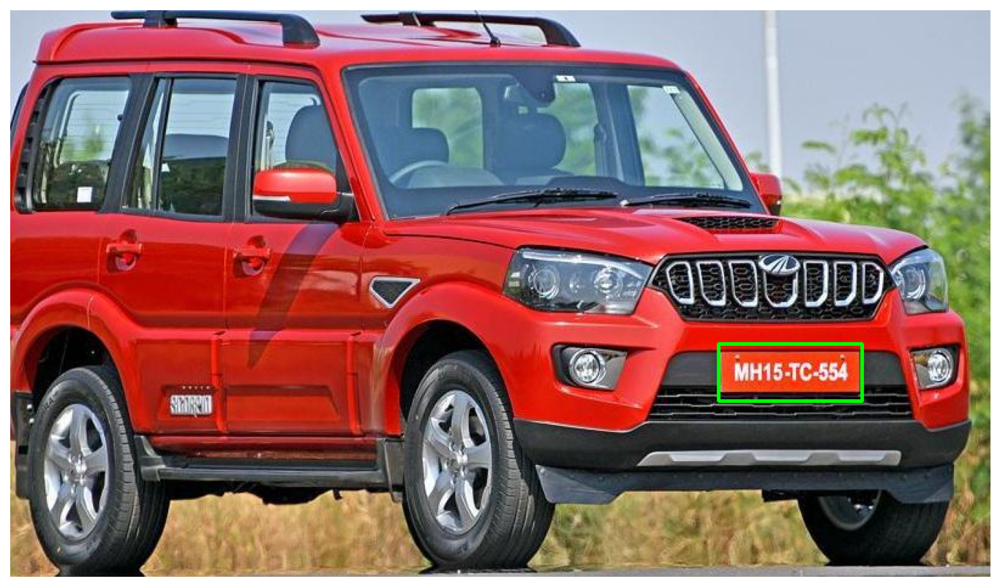

In [15]:
img_df = df[df.file_name == df.file_name.unique()[0]]
img = annotate_image(img_df, resize=False)

plt.imshow(img)
plt.axis('off');

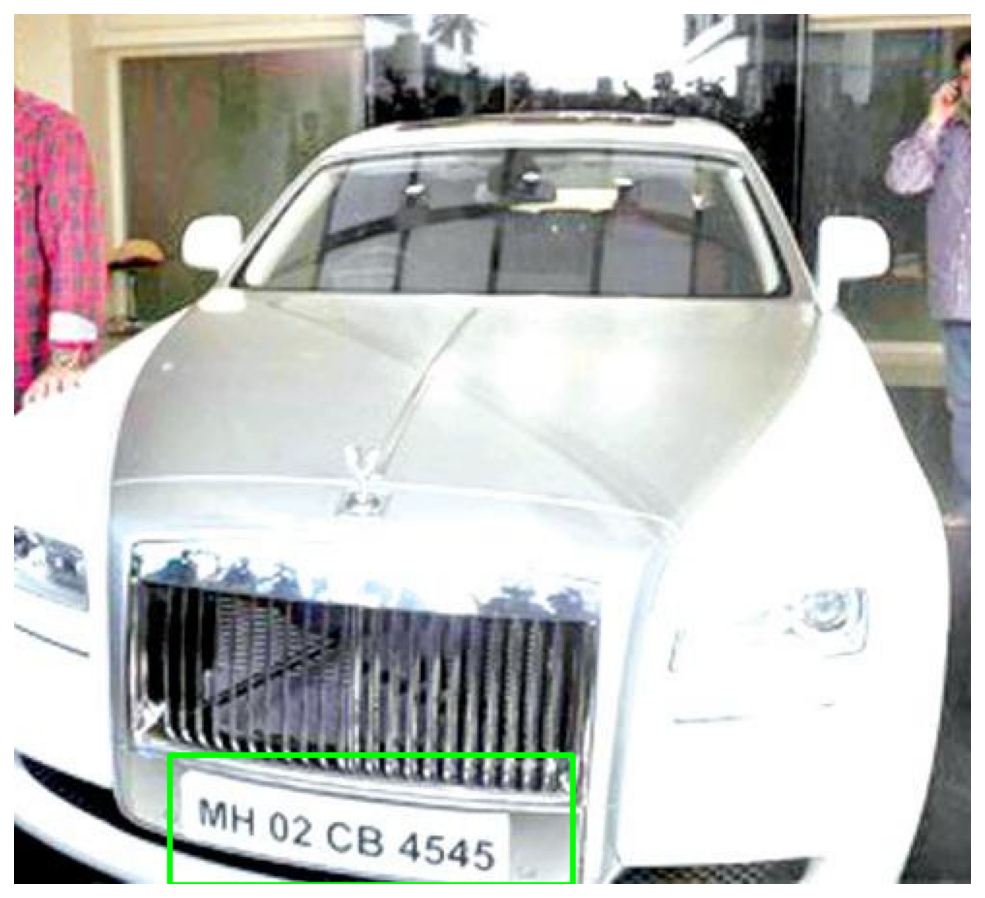

In [16]:
img_df = df[df.file_name == df.file_name.unique()[1]]
img = annotate_image(img_df, resize=False)

plt.imshow(img)
plt.axis('off');

In [17]:
sample_images = [annotate_image(df[df.file_name == f]) for f in df.file_name.unique()[:10]]
sample_images = torch.as_tensor(sample_images)

In [18]:
sample_images.shape

torch.Size([10, 384, 384, 3])

In [19]:
sample_images = sample_images.permute(0, 3, 1, 2)

In [20]:
sample_images.shape

torch.Size([10, 3, 384, 384])

In [21]:


plt.figure(figsize=(24, 12))
grid_img = torchvision.utils.make_grid(sample_images, nrow=5)

plt.imshow(grid_img.permute(1, 2, 0))
plt.axis('off');



Output hidden; open in https://colab.research.google.com to view.

In [22]:
df = pd.read_csv('annotations.csv')

IMAGES_PATH = f'plate'

unique_files = df.file_name.unique()

train_files = set(np.random.choice(unique_files, int(len(unique_files) * 0.95), replace=False))
train_df = df[df.file_name.isin(train_files)]
test_df = df[~df.file_name.isin(train_files)]

train_df.head()

,file_name,width,height,x_min,y_min,x_max,y_max,class_name
0,plate_0.jpeg,806,466,582,274,700,321,license plate
1,plate_1.jpeg,494,449,80,382,288,449,license plate
2,plate_2.jpeg,500,314,41,219,115,260,license plate
3,plate_3.jpeg,500,469,217,313,359,359,license plate
4,plate_4.jpeg,1001,563,209,220,866,554,license plate


In [23]:
classes = df.class_name.unique().tolist()

In [24]:
def create_dataset_dicts(df, classes):
  dataset_dicts = []
  for image_id, img_name in enumerate(df.file_name.unique()):

    record = {}

    image_df = df[df.file_name == img_name]

    file_path = f'{IMAGES_PATH}/{img_name}'
    record["file_name"] = file_path
    record["image_id"] = image_id
    record["height"] = int(image_df.iloc[0].height)
    record["width"] = int(image_df.iloc[0].width)

    objs = []
    for _, row in image_df.iterrows():

      xmin = int(row.x_min)
      ymin = int(row.y_min)
      xmax = int(row.x_max)
      ymax = int(row.y_max)

      poly = [
          (xmin, ymin), (xmax, ymin), 
          (xmax, ymax), (xmin, ymax)
      ]
      poly = list(itertools.chain.from_iterable(poly))

      obj = {
        "bbox": [xmin, ymin, xmax, ymax],
        "bbox_mode": BoxMode.XYXY_ABS,
        "segmentation": [poly],
        "category_id": classes.index(row.class_name),
        "iscrowd": 0
      }
      objs.append(obj)

    record["annotations"] = objs
    dataset_dicts.append(record)
  return dataset_dicts

In [25]:
for d in ["train", "val"]:
  DatasetCatalog.register("plate_" + d, lambda d=d: create_dataset_dicts(train_df if d == "train" else test_df, classes))
  MetadataCatalog.get("plate_" + d).set(thing_classes=classes)

statement_metadata = MetadataCatalog.get("plate_train")

In [26]:
class CocoTrainer(DefaultTrainer):
  
  @classmethod
  def build_evaluator(cls, cfg, dataset_name, output_folder=None):

    if output_folder is None:
        os.makedirs("coco_eval", exist_ok=True)
        output_folder = "coco_eval"

    return COCOEvaluator(dataset_name, cfg, False, output_folder)

In [28]:
!cat 'COCO-InstanceSegmentation/mask_rcnn_X_101_32x8d_FPN_3x.yaml'

cat: COCO-InstanceSegmentation/mask_rcnn_X_101_32x8d_FPN_3x.yaml: No such file or directory


In [29]:
cfg = get_cfg()

cfg.merge_from_file(
  model_zoo.get_config_file(
    "COCO-InstanceSegmentation/mask_rcnn_X_101_32x8d_FPN_3x.yaml"
  )
)

cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url(
  "COCO-InstanceSegmentation/mask_rcnn_X_101_32x8d_FPN_3x.yaml"
)

In [30]:
cfg.DATASETS.TRAIN = ("plate_train",)
cfg.DATASETS.TEST = ("plate_val",)
cfg.DATALOADER.NUM_WORKERS = 4

In [31]:
cfg.SOLVER.IMS_PER_BATCH = 4
cfg.SOLVER.BASE_LR = 0.001
cfg.SOLVER.WARMUP_ITERS = 1000
cfg.SOLVER.MAX_ITER = 1500
cfg.SOLVER.STEPS = (1000, 1500)
cfg.SOLVER.GAMMA = 0.05

In [32]:
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 64
cfg.MODEL.ROI_HEADS.NUM_CLASSES = len(classes)

cfg.TEST.EVAL_PERIOD = 500

In [33]:
cfg

CfgNode({'VERSION': 2, 'MODEL': CfgNode({'LOAD_PROPOSALS': False, 'MASK_ON': True, 'KEYPOINT_ON': False, 'DEVICE': 'cuda', 'META_ARCHITECTURE': 'GeneralizedRCNN', 'WEIGHTS': 'https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_X_101_32x8d_FPN_3x/139653917/model_final_2d9806.pkl', 'PIXEL_MEAN': [103.53, 116.28, 123.675], 'PIXEL_STD': [57.375, 57.12, 58.395], 'BACKBONE': CfgNode({'NAME': 'build_resnet_fpn_backbone', 'FREEZE_AT': 2}), 'FPN': CfgNode({'IN_FEATURES': ['res2', 'res3', 'res4', 'res5'], 'OUT_CHANNELS': 256, 'NORM': '', 'FUSE_TYPE': 'sum'}), 'PROPOSAL_GENERATOR': CfgNode({'NAME': 'RPN', 'MIN_SIZE': 0}), 'ANCHOR_GENERATOR': CfgNode({'NAME': 'DefaultAnchorGenerator', 'SIZES': [[32], [64], [128], [256], [512]], 'ASPECT_RATIOS': [[0.5, 1.0, 2.0]], 'ANGLES': [[-90, 0, 90]], 'OFFSET': 0.0}), 'RPN': CfgNode({'HEAD_NAME': 'StandardRPNHead', 'IN_FEATURES': ['p2', 'p3', 'p4', 'p5', 'p6'], 'BOUNDARY_THRESH': -1, 'IOU_THRESHOLDS': [0.3, 0.7], 'IOU_LABELS': [0, -1,

In [ ]:
os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)

trainer = CocoTrainer(cfg) 
trainer.resume_or_load(resume=False)
trainer.train()

[09/25 05:01:41 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

Skip loading parameter 'roi_heads.box_predictor.cls_score.weight' to the model due to incompatible shapes: (81, 1024) in the checkpoint but (2, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.cls_score.bias' to the model due to incompatible shapes: (81,) in the checkpoint but (2,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.weight' to the model due to incompatible shapes: (320, 1024) in the checkpoint but (4, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.bias' to the model due to incompatible shapes: (320,) in the checkpoint but (4,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.mask_head.predictor.weight' to the model due to incompatible shapes: (80, 256, 1, 1) in the checkpoint but (1, 256, 1, 1) in

[09/25 05:01:42 d2.engine.train_loop]: Starting training from iteration 0


/usr/local/lib/python3.6/dist-packages/detectron2/structures/masks.py:331: UserWarning: This overload of nonzero is deprecated:
	nonzero()
Consider using one of the following signatures instead:
	nonzero(*, bool as_tuple) (Triggered internally at  /pytorch/torch/csrc/utils/python_arg_parser.cpp:766.)
  item = item.nonzero().squeeze(1).cpu().numpy().tolist()
/usr/local/lib/python3.6/dist-packages/detectron2/structures/masks.py:331: UserWarning: This overload of nonzero is deprecated:
	nonzero()
Consider using one of the following signatures instead:
	nonzero(*, bool as_tuple) (Triggered internally at  /pytorch/torch/csrc/utils/python_arg_parser.cpp:766.)
  item = item.nonzero().squeeze(1).cpu().numpy().tolist()
/usr/local/lib/python3.6/dist-packages/detectron2/structures/masks.py:331: UserWarning: This overload of nonzero is deprecated:
	nonzero()
Consider using one of the following signatures instead:
	nonzero(*, bool as_tuple) (Triggered internally at  /pytorch/torch/csrc/utils/python

[09/25 05:02:41 d2.utils.events]:  eta: 1:08:29  iter: 19  total_loss: 1.840  loss_cls: 0.710  loss_box_reg: 0.337  loss_mask: 0.676  loss_rpn_cls: 0.049  loss_rpn_loc: 0.012  time: 2.9481  data_time: 0.0462  lr: 0.000020  max_mem: 11696M
[09/25 05:03:51 d2.utils.events]:  eta: 1:18:31  iter: 39  total_loss: 1.427  loss_cls: 0.471  loss_box_reg: 0.343  loss_mask: 0.550  loss_rpn_cls: 0.043  loss_rpn_loc: 0.010  time: 3.2385  data_time: 0.0191  lr: 0.000040  max_mem: 11696M
[09/25 05:04:57 d2.utils.events]:  eta: 1:19:54  iter: 59  total_loss: 1.189  loss_cls: 0.315  loss_box_reg: 0.398  loss_mask: 0.404  loss_rpn_cls: 0.045  loss_rpn_loc: 0.012  time: 3.2643  data_time: 0.0222  lr: 0.000060  max_mem: 11696M
[09/25 05:06:06 d2.utils.events]:  eta: 1:19:30  iter: 79  total_loss: 1.282  loss_cls: 0.285  loss_box_reg: 0.571  loss_mask: 0.373  loss_rpn_cls: 0.011  loss_rpn_loc: 0.009  time: 3.3046  data_time: 0.0179  lr: 0.000080  max_mem: 11696M
[09/25 05:07:15 d2.utils.events]:  eta: 1:19

In [ ]:
%load_ext tensorboard



In [ ]:
%tensorboard --logdir output

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.85
predictor = DefaultPredictor(cfg)

In [ ]:
evaluator = COCOEvaluator("plate_val", cfg, False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, "plate_val")
inference_on_dataset(trainer.model, val_loader, evaluator)

[09/25 06:52:01 d2.data.common]: Serializing 12 elements to byte tensors and concatenating them all ...
[09/25 06:52:01 d2.data.common]: Serialized dataset takes 0.00 MiB
[09/25 06:52:01 d2.data.dataset_mapper]: Augmentations used in training: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[09/25 06:52:01 d2.evaluation.evaluator]: Start inference on 12 images
[09/25 06:52:04 d2.evaluation.evaluator]: Inference done 11/12. 0.2867 s / img. ETA=0:00:00
[09/25 06:52:05 d2.evaluation.evaluator]: Total inference time: 0:00:02.130756 (0.304394 s / img per device, on 1 devices)
[09/25 06:52:05 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:01 (0.283064 s / img per device, on 1 devices)
[09/25 06:52:05 d2.evaluation.coco_evaluation]: Preparing results for COCO format ...
[09/25 06:52:05 d2.evaluation.coco_evaluation]: Saving results to ./output/coco_instances_results.json
[09/25 06:52:05 d2.evaluation.coco_evaluation]: Evaluating pred

OrderedDict([('bbox',
              {'AP': 41.88343834383439,
               'AP50': 89.02640264026401,
               'AP75': 37.12871287128713,
               'APl': 50.001768033946256,
               'APm': 34.52970297029702,
               'APs': nan}),
             ('segm',
              {'AP': 41.149114911491154,
               'AP50': 89.02640264026401,
               'AP75': 19.801980198019802,
               'APl': 50.22454031117398,
               'APm': 33.26732673267327,
               'APs': nan})])

In [ ]:
os.makedirs("annotated_results", exist_ok=True)

test_image_paths = test_df.file_name.unique()

In [ ]:
os.makedirs("annotated_results_bw", exist_ok=True)

In [ ]:
for clothing_image in test_image_paths:
  file_path = f'{IMAGES_PATH}/{clothing_image}'
  im = cv2.imread(file_path)
  outputs = predictor(im)
  v = Visualizer(
    im[:, :, ::-1],
    metadata=statement_metadata, 
    scale=1., 
    instance_mode=ColorMode.IMAGE
  )
  instances = outputs["instances"].to("cpu")
  instances.remove('pred_masks')
  v = v.draw_instance_predictions(instances)
  result = v.get_image()[:, :, ::-1]
  file_name = ntpath.basename(clothing_image)
  write_res = cv2.imwrite(f'annotated_results/{file_name}', result)

In [ ]:
for clothing_image in test_image_paths:
  file_path = f'{IMAGES_PATH}/{clothing_image}'
  im = cv2.imread(file_path)
  outputs = predictor(im)
  v = Visualizer(
    im[:, :, ::-1],
    metadata=statement_metadata, 
    scale=1., 
    instance_mode=ColorMode.IMAGE_BW
  )
  instances = outputs["instances"].to("cpu")
  #instances.remove('pred_masks')
  v = v.draw_instance_predictions(instances)
  result = v.get_image()[:, :, ::-1]
  file_name = ntpath.basename(clothing_image)
  write_res = cv2.imwrite(f'annotated_results_bw/{file_name}', result)

In [ ]:
from detectron2.utils.visualizer import ColorMode
dataset_dicts = get_balloon_dicts("balloon/val")
for d in random.sample(dataset_dicts, 3):    
    im = cv2.imread(d["file_name"])
    outputs = predictor(im)  # format is documented at https://detectron2.readthedocs.io/tutorials/models.html#model-output-format
    v = Visualizer(im[:, :, ::-1],
                   metadata=balloon_metadata, 
                   scale=0.5, 
                   instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels. This option is only available for segmentation models
    )
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(out.get_image()[:, :, ::-1])

NameError: ignored

In [ ]:
annotated_images = [f'annotated_results/{f}' for f in test_df.file_name.unique()]

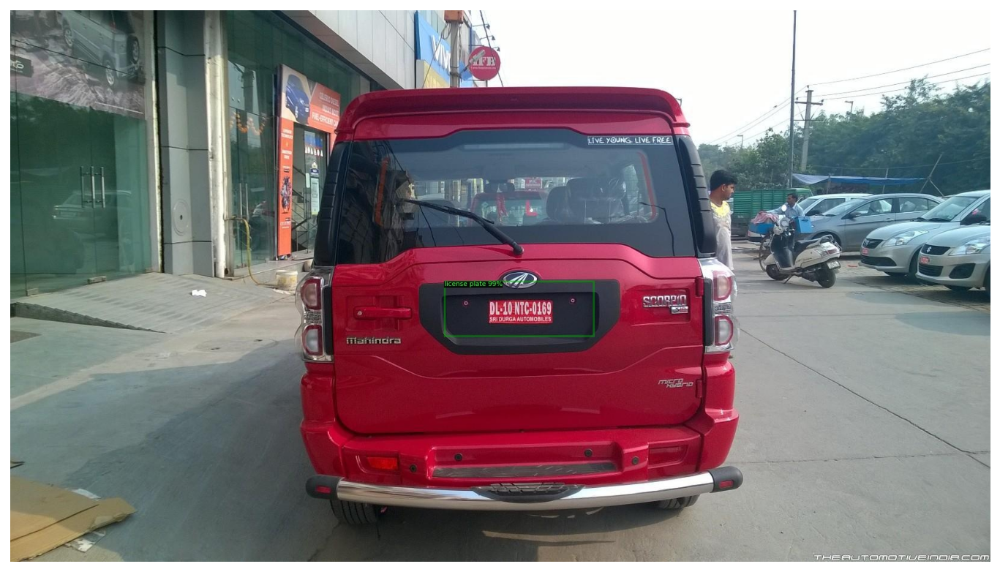

In [ ]:
img = cv2.cvtColor(cv2.imread(annotated_images[0]), cv2.COLOR_BGR2RGB)

plt.imshow(img)
plt.axis('off');

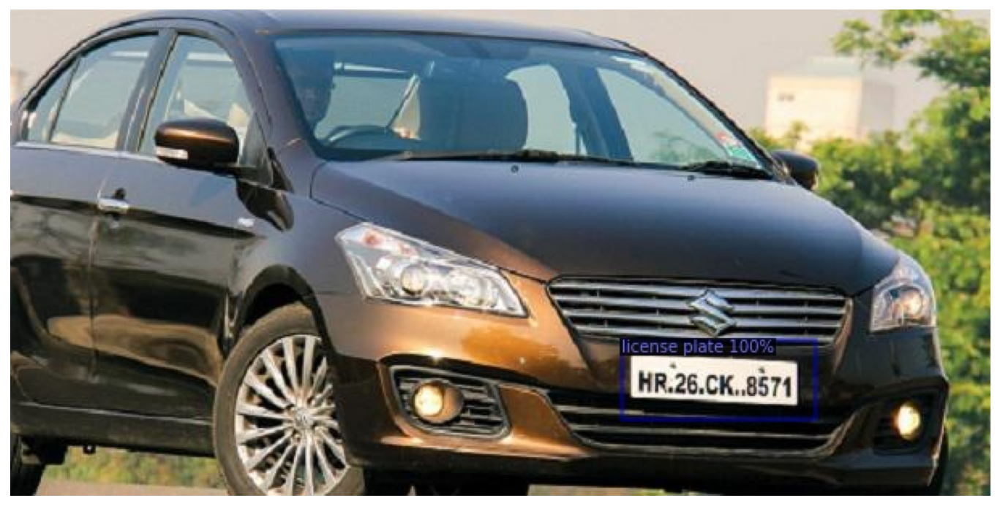

In [ ]:
img = cv2.cvtColor(cv2.imread(annotated_images[1]), cv2.COLOR_BGR2RGB)

plt.imshow(img)
plt.axis('off');

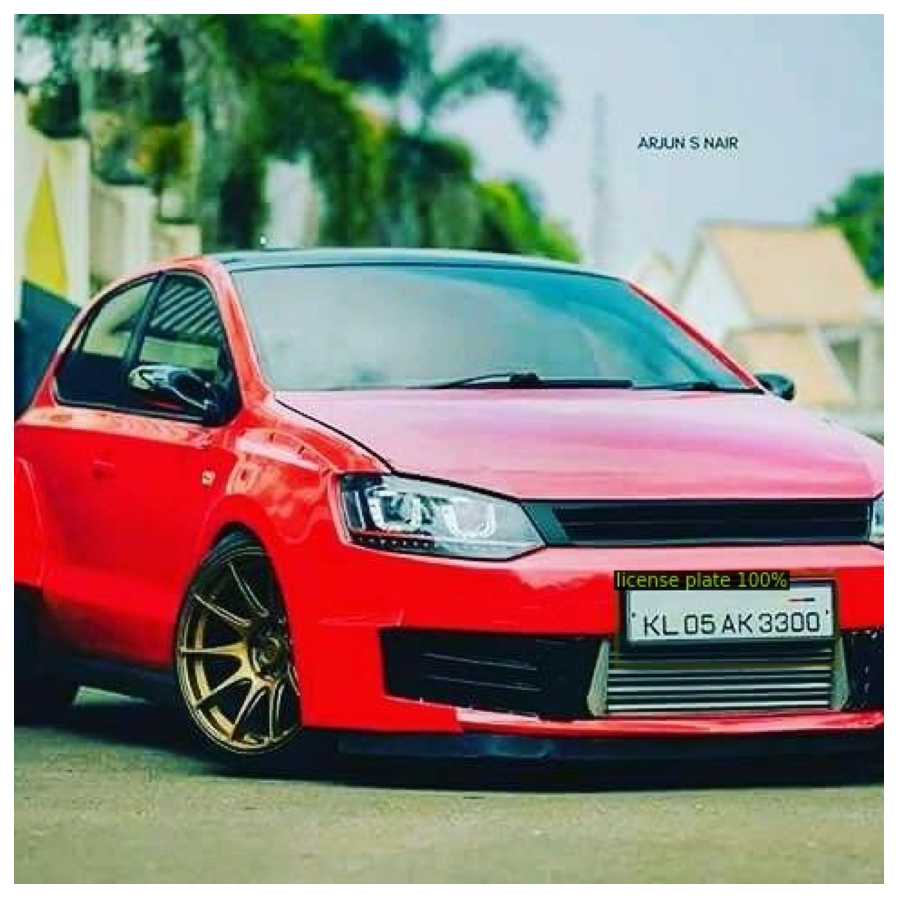

In [ ]:
img = cv2.cvtColor(cv2.imread(annotated_images[2]), cv2.COLOR_BGR2RGB)

plt.imshow(img)
plt.axis('off');

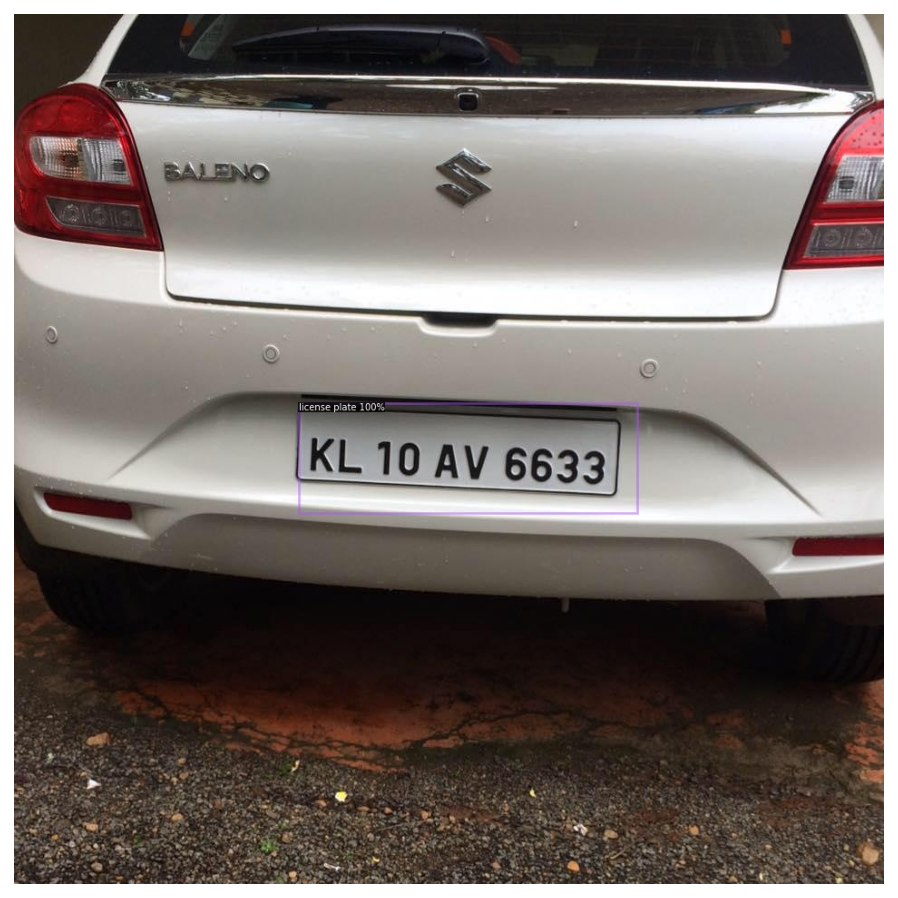

In [ ]:
img = cv2.cvtColor(cv2.imread(annotated_images[3]), cv2.COLOR_BGR2RGB)

plt.imshow(img)
plt.axis('off');

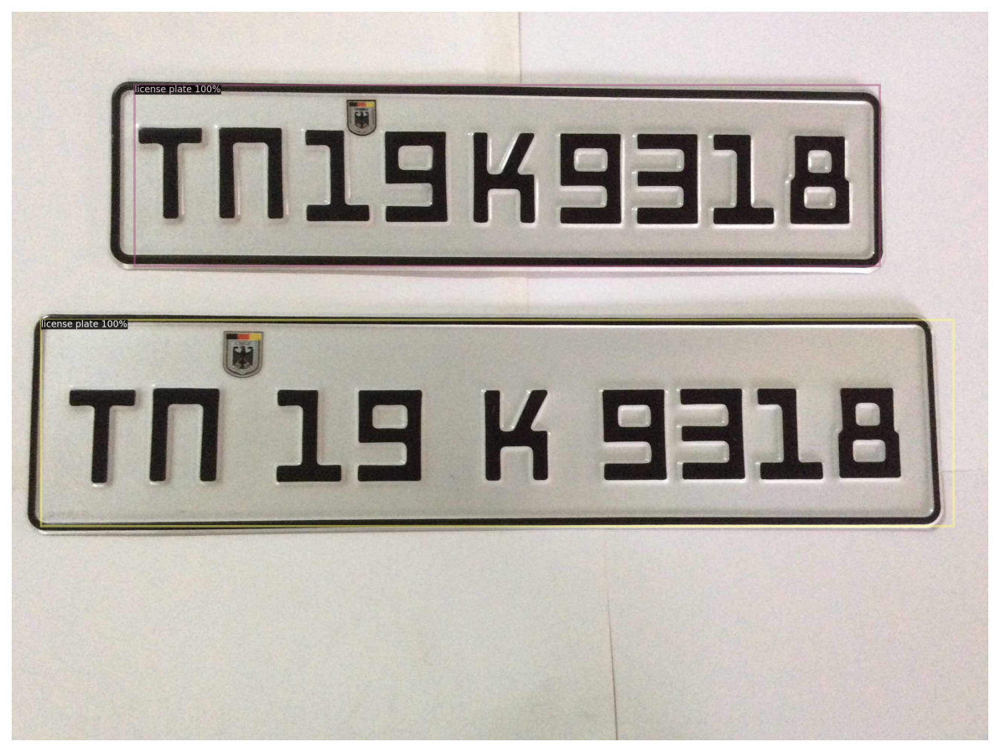

In [ ]:
img = cv2.cvtColor(cv2.imread(annotated_images[4]), cv2.COLOR_BGR2RGB)

plt.imshow(img)
plt.axis('off');

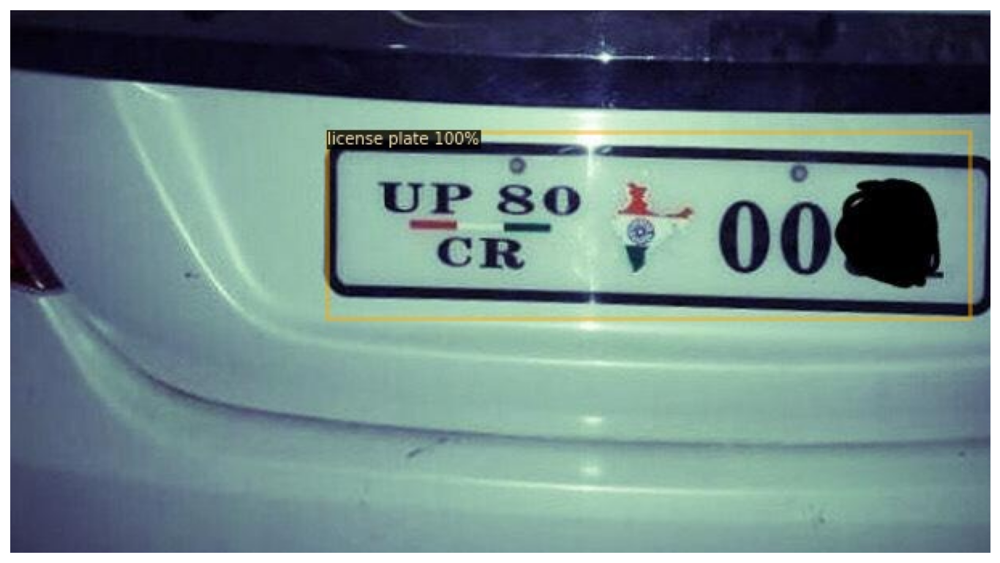

In [ ]:
img = cv2.cvtColor(cv2.imread(annotated_images[5]), cv2.COLOR_BGR2RGB)

plt.imshow(img)
plt.axis('off');

In [ ]:
from detectron2.utils.visualizer import ColorMode
dataset_dicts = get_balloon_dicts("balloon/val")
for d in random.sample(dataset_dicts, 3):    
    im = cv2.imread(d["file_name"])
    outputs = predictor(im)  # format is documented at https://detectron2.readthedocs.io/tutorials/models.html#model-output-format
    v = Visualizer(im[:, :, ::-1],
                   metadata=balloon_metadata, 
                   scale=0.5, 
                   instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels. This option is only available for segmentation models
    )
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(out.get_image()[:, :, ::-1])

In [ ]:
annotated_images_bw = [f'annotated_results_bw/{f}' for f in test_df.file_name.unique()]

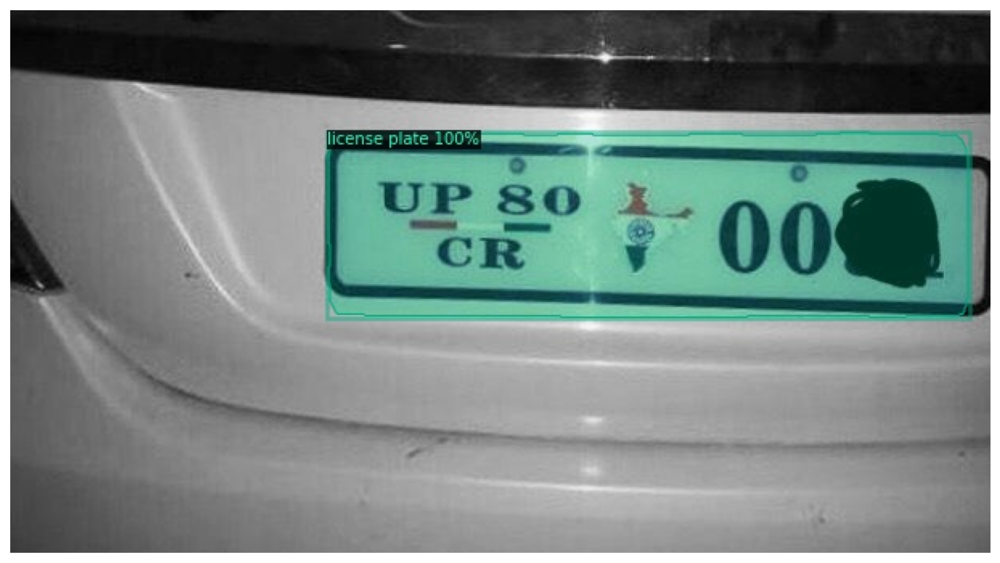

In [ ]:
img = cv2.cvtColor(cv2.imread(annotated_images_bw[5]), cv2.COLOR_BGR2RGB)

plt.imshow(img)
plt.axis('off');

In [ ]:
%pwd

'/content'

In [ ]:
len(annotated_images_bw )

12

In [ ]:
%ls -a

 ./        annotated_results/   .config/                    plate/
 ../       annotations.csv      Indian_Number_plates.json   sample_data/
'=2.0.1'   coco_eval/           output/


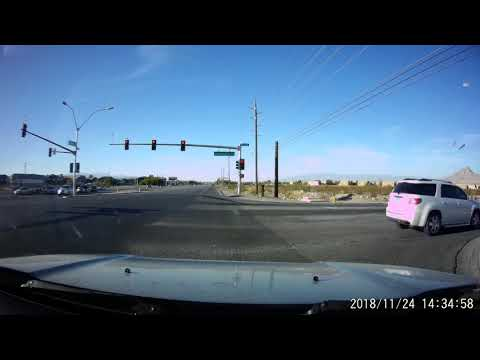

In [ ]:
# This is the video we're going to process
from IPython.display import YouTubeVideo, display
video = YouTubeVideo("zbX6BRlDF3w", width=500)
display(video)

In [ ]:
# Install dependencies, download the video, and crop 5 seconds for processing
!pip install youtube-dl
!pip uninstall -y opencv-python-headless opencv-contrib-python
!apt install python3-opencv  # the one pre-installed have some issues
!youtube-dl https://www.youtube.com/watch?v=ll8TgCZ0plk -f 22 -o video.mp4
!ffmpeg -i video.mp4 -t 00:01:13 -c:v copy video_cam.mp4

Reading package lists... Done
Building dependency tree       
Reading state information... Done
python3-opencv is already the newest version (3.2.0+dfsg-4ubuntu0.1).
0 upgraded, 0 newly installed, 0 to remove and 11 not upgraded.
[youtube] ll8TgCZ0plk: Downloading webpage
[download] video.mp4 has already been downloaded
[download] 100% of 404.40MiB
ffmpeg version 3.4.8-0ubuntu0.2 Copyright (c) 2000-2020 the FFmpeg developers
  built with gcc 7 (Ubuntu 7.5.0-3ubuntu1~18.04)
  configuration: --prefix=/usr --extra-version=0ubuntu0.2 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --enable-gpl --disable-stripping --enable-avresample --enable-avisynth --enable-gnutls --enable-ladspa --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enab

In [ ]:
!git clone https://github.com/facebookresearch/detectron2
!python detectron2/demo/demo.py --config-file detectron2/configs/COCO-PanopticSegmentation/panoptic_fpn_R_101_3x.yaml --video-input video-clip.mp4 --confidence-threshold 0.6 --output video-output.mkv \
  --opts MODEL.WEIGHTS output/model_final.pth

fatal: destination path 'detectron2' already exists and is not an empty directory.
Failed to load OpenCL runtime
[09/25 11:25:00 detectron2]: Arguments: Namespace(confidence_threshold=0.6, config_file='detectron2/configs/COCO-PanopticSegmentation/panoptic_fpn_R_101_3x.yaml', input=None, opts=['MODEL.WEIGHTS', 'output/model_final.pth'], output='video-output.mkv', video_input='video-clip.mp4', webcam=False)
Traceback (most recent call last):
  File "detectron2/demo/demo.py", line 79, in <module>
    demo = VisualizationDemo(cfg)
  File "/content/detectron2/demo/predictor.py", line 35, in __init__
    self.predictor = DefaultPredictor(cfg)
  File "/usr/local/lib/python3.6/dist-packages/detectron2/engine/defaults.py", line 182, in __init__
    self.model = build_model(self.cfg)
  File "/usr/local/lib/python3.6/dist-packages/detectron2/modeling/meta_arch/build.py", line 22, in build_model
    model.to(torch.device(cfg.MODEL.DEVICE))
  File "/usr/local/lib/python3.6/dist-packages/torch/nn/mo

In [ ]:
!touch traffic.yaml

In [ ]:
frame_width = int(video.get(3)) 
frame_height = int(video.get(4)) 
   
size = (frame_width, frame_height) 
   
# Below VideoWriter object will create 
# a frame of above defined The output  
# is stored in 'filename.avi' file. 
result = cv2.VideoWriter('filename_1.avi',  
                         cv2.VideoWriter_fourcc(*'MJPG'), 
                         10, size) 

result.write(frame) 
  
        # Display the frame 
        # saved in the file 
        cv2.imshow('Frame', frame) 
  
        # Press S on keyboard  
        # to stop the process 
        if cv2.waitKey(1) & 0xFF == ord('s'): 
            break
  
    # Break the loop 
    else: 
        break
  
# When everything done, release  
# the video capture and video  
# write objects 
video.release() 
result.release() 
    
# Closes all the frames 
cv2.destroyAllWindows() 

In [ ]:
im = cv2.imread(file_path)
  outputs = predictor(im)
  v = Visualizer(
    im[:, :, ::-1],
    metadata=statement_metadata, 
    scale=1., 
    instance_mode=ColorMode.IMAGE
  )
  instances = outputs["instances"].to("cpu")
  instances.remove('pred_masks')
  v = v.draw_instance_predictions(instances)
  result = v.get_image()[:, :, ::-1]
  file_name = ntpath.basename(clothing_image)
  write_res = cv2.imwrite(f'annotated_results/{file_name}', result)

In [ ]:
cap=cv2.VideoCapture('video_1.mp4')
frame_width = int(cap.get(3)) 
frame_height = int(cap.get(4)) 
   
size = (frame_width, frame_height) 
print(size)
result = cv2.VideoWriter('final_12.avi',  
                         cv2.VideoWriter_fourcc(*'MJPG'), 
                         10, size) 

while True:
        _,im=cap.read()
        outputs = predictor(im)
        v = Visualizer(
            im[:, :, ::-1],
                metadata=statement_metadata, 
                  scale=0.5, 
                  instance_mode=ColorMode.IMAGE
                    ) 
        instances = outputs["instances"].to("cpu")
        instances.remove('pred_masks')
        v = v.draw_instance_predictions(instances)
        result11 = v.get_image()[:, :, ::-1]    
        result.write(result11)

        ch = 0xFF & cv2.waitKey(1)
        if ch == 27:
            break
#cv2.destroyAllWindows()
cap.release() 
result.release() 

(3840, 2160)


AttributeError: ignored

In [ ]:
# Download the results
from google.colab import files
files.download('final_12.avi')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [6]:
!git clone https://github.com/facebookresearch/detectron2


Cloning into 'detectron2'...
remote: Enumerating objects: 7152, done.
remote: Total 7152 (delta 0), reused 0 (delta 0), pack-reused 7152
Receiving objects: 100% (7152/7152), 3.30 MiB | 23.94 MiB/s, done.
Resolving deltas: 100% (5070/5070), done.


In [34]:
!python detectron2/demo/demo.py --config-file detectron2/configs/COCO-InstanceSegmentation/mask_rcnn_X_101_32x8d_FPN_3x.yaml --video-input /mydrive/plate/plate.mp4 --confidence-threshold 0.6 --output video-output.mkv \
  --opts MODEL.WEIGHTS /mydrive/plate/model_final.pth

[09/27 10:10:54 detectron2]: Arguments: Namespace(confidence_threshold=0.6, config_file='detectron2/configs/COCO-InstanceSegmentation/mask_rcnn_X_101_32x8d_FPN_3x.yaml', input=None, opts=['MODEL.WEIGHTS', '/mydrive/plate/model_final.pth'], output='video-output.mkv', video_input='/mydrive/plate/plate.mp4', webcam=False)
[09/27 10:11:00 fvcore.common.checkpoint]: Loading checkpoint from /mydrive/plate/model_final.pth
WARNING [09/27 10:11:01 fvcore.common.checkpoint]: Skip loading parameter 'roi_heads.box_predictor.cls_score.weight' to the model due to incompatible shapes: (2, 1024) in the checkpoint but (81, 1024) in the model! You might want to double check if this is expected.
WARNING [09/27 10:11:01 fvcore.common.checkpoint]: Skip loading parameter 'roi_heads.box_predictor.cls_score.bias' to the model due to incompatible shapes: (2,) in the checkpoint but (81,) in the model! You might want to double check if this is expected.
WARNING [09/27 10:11:01 fvcore.common.checkpoint]: Skip loa